# A look at the public LB standings over time.
This is a fun kernel to show the progress of teams on the public leaderboard during the competition. I will try my best to update this kernel frequently with the latest standings.

**Last updated Jun 20, 2019**

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import matplotlib.pylab as plt
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
plt.style.use('ggplot')
color_pal = [x['color'] for x in plt.rcParams['axes.prop_cycle']]

# Format the data
df = pd.read_csv('../input/instant-gratification-leaderboard/instant-gratification-publicleaderboard_06_20_2019.csv')
df['SubmissionDate'] = pd.to_datetime(df['SubmissionDate'])
df = df.set_index(['TeamName','SubmissionDate'])['Score'].unstack(-1).T
df.columns = [name for name in df.columns]

In [2]:
FIFTEENTH_SCORE = df.max().sort_values(ascending=False)[15]
FIFTYTH_SCORE = df.max().sort_values(ascending=False)[50]
TOP_SCORE = df.max().sort_values(ascending=False)[0]

# Public LB Scores of Top Teams over time

In [3]:
# Interative Plotly
init_notebook_mode(connected=True)
TOP_TEAMS = df.min().loc[df.max() > FIFTEENTH_SCORE].index.values
df_filtered = df[TOP_TEAMS].ffill()
df_filtered = df_filtered.iloc[df_filtered.index > '05-22-2019']
# Create a trace
data = []
for col in df_filtered.columns:
    data.append(go.Scatter(
                        x = df_filtered.index,
                        y = df_filtered[col],
                        name=col)
               )
layout = go.Layout(yaxis=dict(range=[0.958, TOP_SCORE+0.0001]))
fig = go.Figure(data=data, layout=layout)
iplot(fig)

# Closer look at the top

In [4]:
# Interative Plotly
init_notebook_mode(connected=True)
TOP_TEAMS = df.min().loc[df.max() > FIFTEENTH_SCORE].index.values
df_filtered = df[TOP_TEAMS].ffill()
df_filtered = df_filtered.iloc[df_filtered.index > '06-3-2019']
# Create a trace
data = []
for col in df_filtered.columns:
    data.append(go.Scatter(
                        x = df_filtered.index,
                        y = df_filtered[col],
                        name=col)
               )
layout = go.Layout(yaxis=dict(range=[0.9746, TOP_SCORE+0.0001]))
fig = go.Figure(data=data, layout=layout)
iplot(fig)

# All competitors LB Position over Time

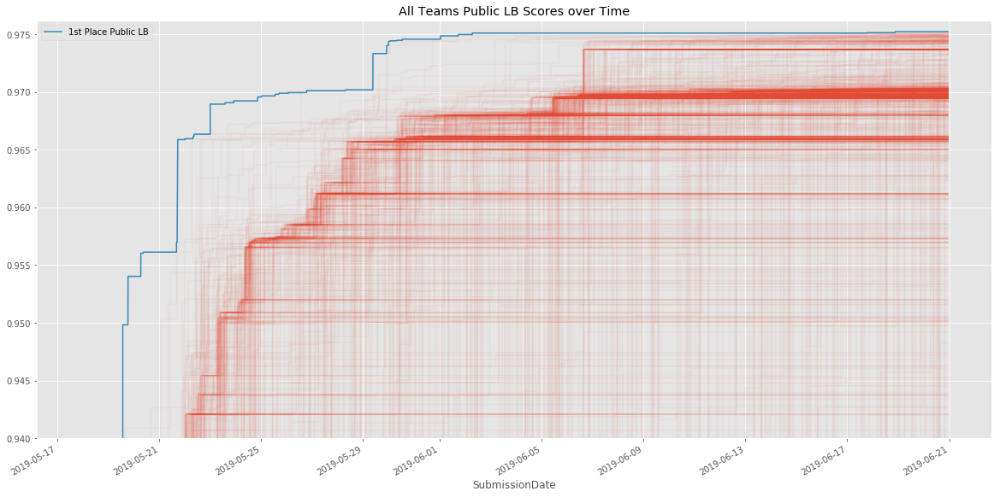

In [5]:
# Scores of top teams over time
ALL_TEAMS = [x for x in df.columns.values if x != 'nan']
df[ALL_TEAMS].ffill().plot(figsize=(20, 10),
                           color=color_pal[0],
                           legend=False,
                           alpha=0.05,
                           ylim=(0.94,TOP_SCORE+0.001),
                           title='All Teams Public LB Scores over Time')
df.ffill().max(axis=1).plot(color=color_pal[1], label='1st Place Public LB', legend=True)
plt.show()

# Top LB Scores

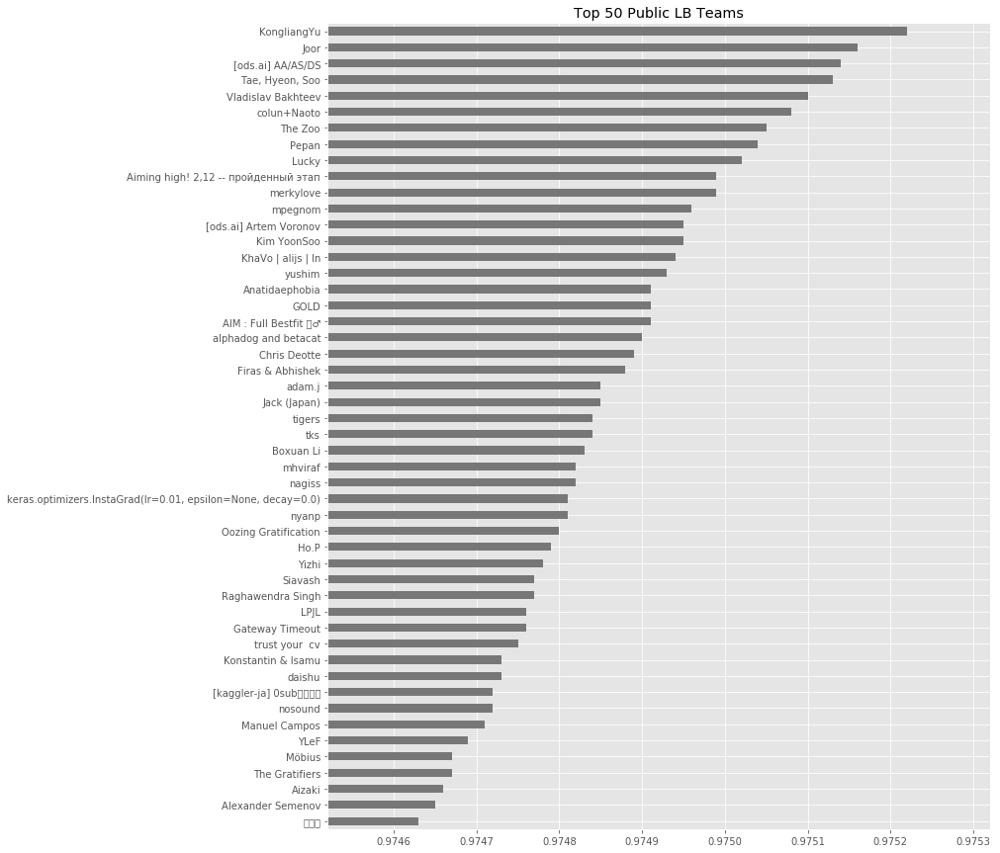

In [6]:
# Create Top Teams List
TOP_TEAMS = df.max().loc[df.max() > FIFTYTH_SCORE].index.values
df[TOP_TEAMS].max().sort_values().plot(kind='barh',
                                       xlim=(FIFTYTH_SCORE-0.0001,TOP_SCORE+0.0001),
                                       title='Top 50 Public LB Teams',
                                       figsize=(12, 15),
                                       color=color_pal[3])
plt.show()

# Count of LB Submissions that improved score

This is the count of times the person submitted and got the fun "You're score improved" notification. This is not the total submission count.

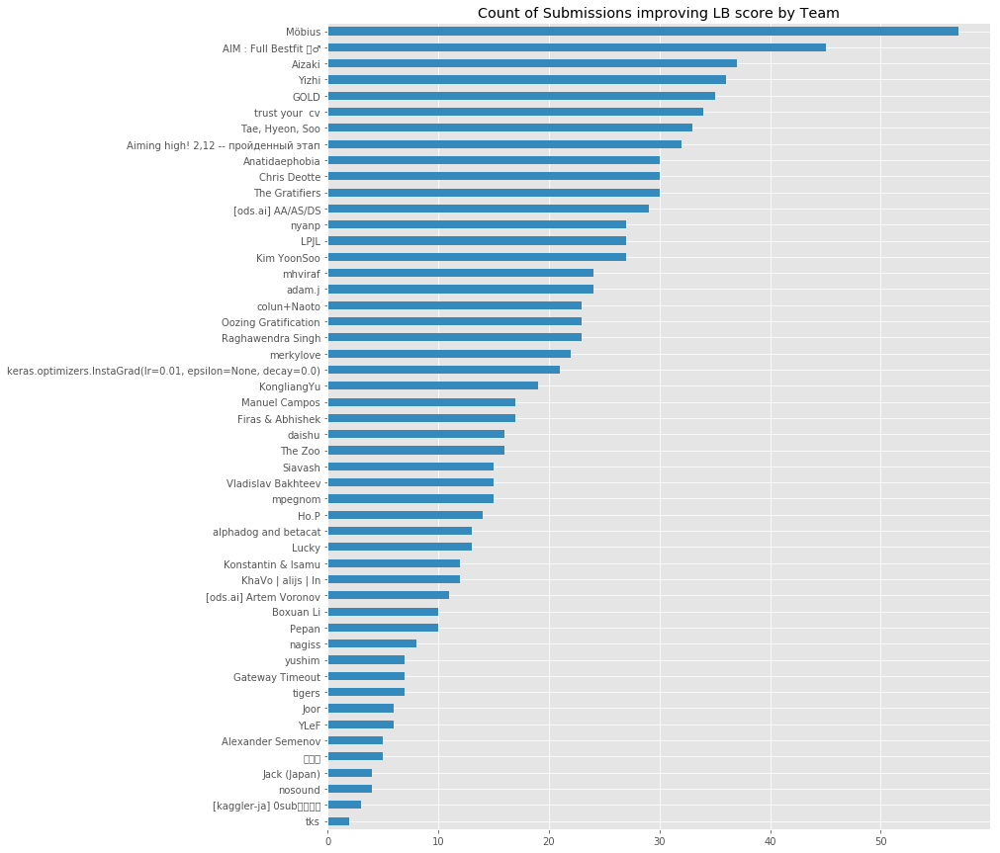

In [7]:
df[TOP_TEAMS].nunique().sort_values().plot(kind='barh',
                                           figsize=(12, 15),
                                           color=color_pal[1],
                                           title='Count of Submissions improving LB score by Team')
plt.show()

# Number of teams by date

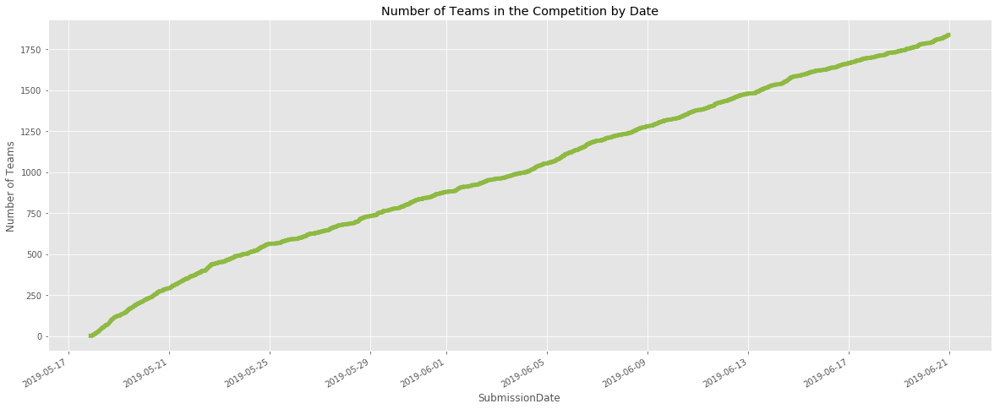

In [8]:
ax =df.ffill() \
    .count(axis=1) \
    .plot(figsize=(20, 8),
          title='Number of Teams in the Competition by Date',
         color=color_pal[5], lw=5)
ax.set_ylabel('Number of Teams')
plt.show()